In [ ]:
import os, torch, copy, cv2, sys, random
# from datetime import datetime, timezone, timedelta
from PIL import Image
import numpy as np
import pandas as pd
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T

In [ ]:
import torchvision.utils as vutils

In [ ]:
import argparse
import os
import numpy as np
import math

import torchvision.transforms as transforms
from torchvision.utils import save_image

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch
os.environ["CUDA_VISIBLE_DEVICES"]="0"
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

#코로나 양성 음성 데이터 분리

In [ ]:
train_label = pd.read_csv('./data/train.csv')

In [ ]:
covid_benign=train_label[train_label.COVID ==1]['file_name']
covid_negative= train_label[train_label.COVID==0]['file_name']

In [ ]:
file_source = './data/train/'
file_destination = './data/benign/'
file_destination2 = './data/negative/'

In [ ]:
for name in covid_benign:  #양성인 파일들을 보내고자하는 경로로 보냄
    os.replace(file_source+name,file_destination+name)

In [ ]:
for name in covid_negative: #음성인 파일들을 보내고자하는 경로로 보냄
    os.replace(file_source + name, file_destination2 + name)

In [ ]:
benign_label=train_label[train_label['file_name'].isin(benign)]
negative_label = train_label[train_label['file_name'].isin(negative)]

In [ ]:
benign_label.to_csv('benign_label', index=False) #데이터로더 형식에 맞추기 위해서 라벨도 같이 만듬
negative_label.to_csv('negative_label', index=False)

#DCGAN을 이용하기 위한 데이터로더.

Baseline 코드를 조금 수정함

In [ ]:
class CustomDataset(Dataset):
    def __init__(self, data_dir, input_shape):
        self.data_dir = data_dir
        # self.mode = mode
        self.input_shape = input_shape
        
        # Loading dataset
        self.db = self.data_loader()
        
        # Dataset split
#         if self.mode == 'train':
#             self.db = self.db[:int(len(self.db) * 0.9)] #train 90퍼
#         elif self.mode == 'val':
#             self.db = self.db[int(len(self.db) * 0.9):] #validation 90퍼부터 100퍼까지
#             self.db.reset_index(inplace=True)
#         else:
#             print(f'!!! Invalid split {self.mode}... !!!')
            
#         # Transform function
        self.transform = transforms.Compose([transforms.Resize(self.input_shape),
                                             transforms.ToTensor(),
                                             transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])

    def data_loader(self):
        # print('Loading ' + self.mode + ' dataset..')
        # if not os.path.isdir(self.data_dir):
        #     print(f'!!! Cannot find {self.data_dir}... !!!')
        #     sys.exit()
        
        # (COVID : 1, No : 0)
        db = pd.read_csv('./benign_label')
        
        return db

    def __len__(self):
        return len(self.db)

    def __getitem__(self, index):
        data = copy.deepcopy(self.db.loc[index])

        # Loading image
        cvimg = cv2.imread(os.path.join(self.data_dir,data['file_name']), cv2.IMREAD_COLOR | cv2.IMREAD_IGNORE_ORIENTATION)
        if not isinstance(cvimg, np.ndarray):
            raise IOError("Fail to read %s" % data['file_name'])

        # Preprocessing images
        trans_image = self.transform(Image.fromarray(cvimg))

        return trans_image, data['COVID']


In [ ]:
DATA_DIR= './'

In [ ]:
import argparse
import os
import numpy as np
import math

import torchvision.transforms as transforms
from torchvision.utils import save_image

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch


In [ ]:
# class Generator(nn.Module):
#     def __init__(self):
#         super(Generator, self).__init__()

#         self.init_size = opt.img_size // 4
#         self.l1 = nn.Sequential(nn.Linear(opt.latent_dim, 128 * self.init_size ** 2))

#         self.conv_blocks = nn.Sequential(
#             nn.BatchNorm2d(128),
#             nn.Upsample(scale_factor=2),
#             nn.Conv2d(128, 128, 3, stride=1, padding=1),
#             nn.BatchNorm2d(128, 0.8),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Upsample(scale_factor=2),
#             nn.Conv2d(128, 64, 3, stride=1, padding=1),
#             nn.BatchNorm2d(64, 0.8),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Conv2d(64, opt.channels, 3, stride=1, padding=1),
#             nn.Tanh(),
#         )

#     def forward(self, z):
#         out = self.l1(z)
#         out = out.view(out.shape[0], 128, self.init_size, self.init_size)
#         img = self.conv_blocks(out)
#         return img


In [ ]:
# class Discriminator(nn.Module):
#     def __init__(self):
#         super(Discriminator, self).__init__()

#         def discriminator_block(in_filters, out_filters, bn=True):
#             block = [nn.Conv2d(in_filters, out_filters, 3, 2, 1), nn.LeakyReLU(0.2, inplace=True), nn.Dropout2d(0.25)]
#             if bn:
#                 block.append(nn.BatchNorm2d(out_filters, 0.8))
#             return block

#         self.model = nn.Sequential(
#             *discriminator_block(opt.channels, 16, bn=False),
#             *discriminator_block(16, 32),
#             *discriminator_block(32, 64),
#             *discriminator_block(64, 128),
#         )

#         # The height and width of downsampled image
#         ds_size = opt.img_size // 2 ** 4
#         self.adv_layer = nn.Sequential(nn.Linear(128 * ds_size ** 2, 1), nn.Sigmoid())

#     def forward(self, img):
#         out = self.model(img)
#         out = out.view(out.shape[0], -1)
#         validity = self.adv_layer(out)

#         return validity



In [ ]:
# generator = Generator()
# discriminator = Discriminator()

NameError: name 'opt' is not defined

In [ ]:
DATA_DIR= './benign'
NUM_CLS = 2

EPOCHS = 30
BATCH_SIZE = 32
LEARNING_RATE = 0.0005
EARLY_STOPPING_PATIENCE = 10
INPUT_SHAPE = 64

os.environ["CUDA_VISIBLE_DEVICES"]="0"
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
train_dataset = CustomDataset(data_dir=DATA_DIR, input_shape=INPUT_SHAPE)

In [ ]:
train_dataset

In [1]:
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)
# drop_last를 추가한이유는 dcgan을 사용할 때 정확하게 배치단위로 끊어서 학습을 시키기 위해서임.
# fake_label 개수를 지정해서 넣었기 때문에 배치단위가 안맞으면 코드가 안돌아감

NameError: ignored

In [ ]:
from matplotlib import pyplot as plt

## 이미지가 잘 불러와졌는지 확인

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<< [[[[-1.6555357  -1.5630252  -1.3338562 ]
   [-1.7069099  -1.5805322  -1.3512855 ]
   [-1.6897851  -1.5980392  -1.3687146 ]
   ...
   [-1.6555357  -1.5805322  -1.3687146 ]
   [-1.0390445  -1.265406   -1.2641394 ]
   [ 1.1700488   0.62535024  0.37420484]]

  [[-1.2445416  -1.1428571  -0.8981263 ]
   [-1.2959158  -1.1428571  -0.9329847 ]
   [-1.2445416  -1.1428571  -0.91555554]
   ...
   [-1.2445416  -1.1428571  -0.9504139 ]
   [-0.78217316 -0.9677871  -0.9852723 ]
   [ 1.2042983   0.64285725  0.39163405]]

  [[-1.2274169  -1.1428571  -0.91555554]
   [-1.2445416  -1.1428571  -0.91555554]
   [-1.2274169  -1.12535    -0.8981263 ]
   ...
   [-1.2102921  -1.1428571  -0.8981263 ]
   [-0.78217316 -0.9502801  -1.0201306 ]
   [ 1.2042983   0.62535024  0.40906325]]

  ...

  [[-1.2616663  -1.177871   -1.1072767 ]
   [-1.5870366  -1.5105042  -1.2989979 ]
   [-1.5356624  -1.4229691  -1.0898474 ]
   ...
   [-2.0494049  -2.0007002  -1.7870152 ]
   [-1.3130406  -1.6155462  -1.5778649 ]
   [ 1.118674

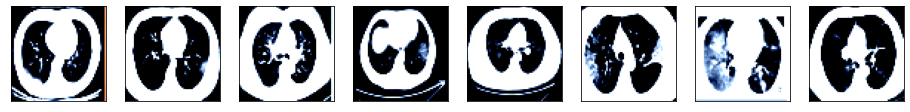

In [ ]:
def show_image(loader, fig_num=8):
    for images, _ in loader:
        images_to_show = images.numpy().transpose((0,2,3,1))
        print('<<',images_to_show)
        fig=plt.figure(figsize=(16, 5))
        for i in range(fig_num):
            fig.add_subplot(1, fig_num, i+1)
            plt.imshow(images_to_show[i])
            plt.xticks([])
            plt.yticks([])    
        fig.show()
        break
show_image(train_dataloader)

torch.Size([32, 3, 64, 64])


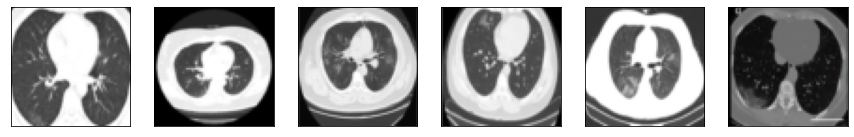

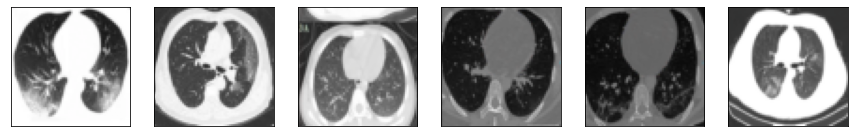

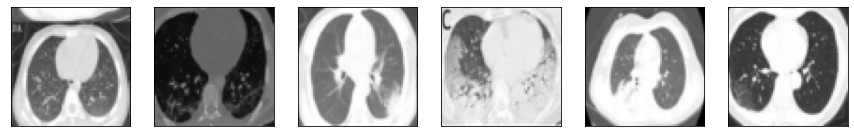

In [ ]:
def show_images(image, n_row):
    for _ in range(n_row):  
        index=np.random.choice(32, 6)
        images =image.numpy()[index]
        plt.figure(figsize=(15,90))    
        for a in range(161, 167):    
            plt.subplot(a)
            plt.imshow(images[(a-161)].transpose(1,2,0))
            plt.xticks([])
            plt.yticks([])    
        plt.show()  

def denorm(x):
    
    mean = torch.FloatTensor([0.485, 0.456, 0.406])
    std = torch.FloatTensor([0.229, 0.224, 0.225])
    
    
    out = x * std[None,:,None,None] + mean[None,:,None,None]
    
    return out.clamp(0,1)
        
for i, (image,_) in enumerate(train_dataloader):
    print(image.squeeze().shape)
    show_images(denorm(image), 3)
    break

In [ ]:
np.random.choice(50, 6)

array([43, 40, 17, 29, 37, 45])

## DCGAN 하이퍼 파라미터

In [ ]:
workers = 4

# Batch size during training
batch_size =  128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 350

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [ ]:
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [ ]:

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Generator Code
#nz =100
#ngf = 64
#nc = 3

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        
        self.main = nn.Sequential(
            
            # input is Z, going into a convolution
            
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf , 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU(True),
            
            nn.ConvTranspose2d( 32, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # 입력데이터 Z가 가장 처음 통과하는 전치 합성곱 계층입니다.
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # 위의 계층을 통과한 데이터의 크기. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [ ]:
# x=torch.randn(b_size, nz, 1, 1, device=device)
# x =torch.ones(32,100,1,1).cuda()
# conv1 = torch.nn.ConvTranspose2d(100,512,4,1,0,bias=False).cuda()
# conv2 = torch.nn.ConvTranspose2d(512,256,4,2,1).cuda()
# conv3 = torch.nn.ConvTranspose2d(256,128,4,2,1).cuda()
# conv4 = torch.nn.ConvTranspose2d(128,64,4,2,1).cuda()
# conv5 = torch.nn.ConvTranspose2d(64,32,4,2,1).cuda()
# conv6 = torch.nn.ConvTranspose2d(32,3,4,2,1).cuda()
# x=conv1(x)
# x=conv2(x)
# print(x.shape)
# x=conv3(x)
# print(x.shape)
# x=conv4(x)
# print(x.shape)
# x=conv5(x)
# print(x.shape)
# x= conv6(x)

torch.Size([32, 256, 8, 8])
torch.Size([32, 128, 16, 16])
torch.Size([32, 64, 32, 32])
torch.Size([32, 32, 64, 64])
torch.Size([32, 3, 128, 128])


In [ ]:
# x =torch.ones(32,100,1,1).cuda()
# y=netG(x)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # 입력 데이터의 크기는 (nc) x 64 x 64 입니다
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
# generator: 가짜 이미지 생성
# input / output 
# input: 랜덤 벡터 


# noise = torch.randn(b_size, nz, 1, 1, device=device)
# fake = netG(noise)
# noise = torch.randn(b_size, nz, 1, 1, device=device)
# fake = netG(noise)
# noise = torch.randn(b_size, nz, 1, 1, device=device)
# fake = netG(noise)
# noise = torch.randn(b_size, nz, 1, 1, device=device)
# ...
# noise = torch.randn(b_size, nz, 1, 1, device=device)
# fake = netG(noise)
# noise = torch.randn(b_size, nz, 1, 1, device=device)
# fake = netG(noise)

# output: 생성된 이미지 (fake image)



# discriminator: 진짜/가짜 구분 


In [ ]:
image_dir = '../augmented_data'

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0


# model 2개 -> G/D
# optimizer 2개 -> G optimizer / D optimizer

real_label = torch.ones((1,), device=device, dtype=torch.float)
fake_label = torch.zeros((1,), device=device, dtype=torch.float)

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(train_dataloader):
        
        # 1. Discriminator 학습
        # - input: 진짜 이미지 -> label: 1
        # - input: 가짜 이미지 (generator가 생성한 이미지) -> label: 0
        
        # 2. Generator 학습
        # - Generator input: noise, output: 가짜 이미지
        # - Discriminator input: 가짜 이미지 -> label : 1
        
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device) # 진짜이미지 
        b_size = real_cpu.size(0)
         # 모두 1로 채워진 (batch) vector
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1) # output = D(진짜이미지) 
        # output = output.type(torch.FloatTensor).cuda()
        # label = label.type(torch.FloatTensor).cuda() # long
        
        # Calculate loss on all-real batch
        errD_real = criterion(output, real_label.detach().expand(output.shape[0])) # label이랑 비교해서 학습 CELoss -> 1이되도록 학습
        # Calculate gradients for D in backward pass
        # errD_real.backward() 
        D_x = output.mean().item()
        # 진짜 이미지를 넣었을 때, discriminator가 내뱉어야하는 값? = 1

        ## Train with all-fake batch
        # 1) 가짜 이미지 만들기
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device) # Gaussian distribution
        # Generate fake image batch with G
        fake = netG(noise)

        
        # 2) 가짜 이미지를 넣으면 0을 예측하도록 학습
        # label.fill_(fake_label) # inplace 
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1) # detach? : generator 는 업데이트 안함. 
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, fake_label.detach().expand(output.shape[0]))
        # Calculate the gradients for this batch
        # errD_fake.backward()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        errD.backward()
        # Update D
        optimizerD.step()
        
        D_G_z1 = output.mean().item()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
        
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device) # Gaussian distribution
        fake = netG(noise) 
        # discriminator가 0이되도록 학습하는 fake image와
        # generator가 1이 되도록 학습하는 fake image가 같으면
        # 서로 상충되게 학습하므로 학습이 unstable해지는 경우가 있습니다.
        # 따라서, 다른 noise vector로 새로 fake 이미지를 만들어 학습합니다. (필수 아님)
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, real_label.detach().expand(output.shape[0])) # 1
        # Calculate gradients for G
        errG.backward()
        # Update G
        optimizerG.step()
        
        D_G_z2 = output.mean().item()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        # 이미지 하나하나 저장하기 위해 조금 수정했음
        if (iters % 5 == 0) or ((epoch == num_epochs-1) and (i == len(train_dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
                # img_list.append(vutils.make_grid(fake, padding=2, normalize=True)) 원래는 그리드로 이미지리스트에 저장
                fake = fake.numpy().transpose(0,2,3,1)
                for j in range(fake.shape[0]):
                    id =j
                    output_=fake[j]
                    output_ = np.clip(output_,a_min=0,a_max=1)
                    plt.imsave(os.path.join(image_dir,'%4d_output.png' % id),output_,cmap=None)

            
        iters += 1

Starting Training Loop...
[0/350][0/9]	Loss_D: 0.0072	Loss_G: 6.9909	D(x): 0.9981	D(G(z)): 0.0051 / 0.0014
[1/350][0/9]	Loss_D: 0.0063	Loss_G: 6.4754	D(x): 0.9948	D(G(z)): 0.0011 / 0.0039
[2/350][0/9]	Loss_D: 0.0048	Loss_G: 6.5175	D(x): 0.9982	D(G(z)): 0.0030 / 0.0035
[3/350][0/9]	Loss_D: 0.0036	Loss_G: 6.6235	D(x): 0.9982	D(G(z)): 0.0018 / 0.0035
[4/350][0/9]	Loss_D: 0.0061	Loss_G: 7.1771	D(x): 0.9972	D(G(z)): 0.0033 / 0.0018
[5/350][0/9]	Loss_D: 0.0069	Loss_G: 7.7340	D(x): 0.9965	D(G(z)): 0.0034 / 0.0008
[6/350][0/9]	Loss_D: 0.0058	Loss_G: 6.3011	D(x): 0.9986	D(G(z)): 0.0044 / 0.0032
[7/350][0/9]	Loss_D: 0.0041	Loss_G: 6.3362	D(x): 0.9980	D(G(z)): 0.0021 / 0.0034
[8/350][0/9]	Loss_D: 0.0046	Loss_G: 6.8862	D(x): 0.9982	D(G(z)): 0.0028 / 0.0021
[9/350][0/9]	Loss_D: 0.0040	Loss_G: 7.0647	D(x): 0.9978	D(G(z)): 0.0018 / 0.0019
[10/350][0/9]	Loss_D: 0.0089	Loss_G: 7.0899	D(x): 0.9957	D(G(z)): 0.0045 / 0.0014
[11/350][0/9]	Loss_D: 0.0042	Loss_G: 7.0065	D(x): 0.9977	D(G(z)): 0.0019 / 0.0015


In [ ]:
# for i, data in enumerate(train_dataloader):
#     real_cpu = data[0].to(device)
#     b_size = real_cpu.size(0)
#     label = torch.full((b_size,), real_label, device=device)
#     output = netD(real_cpu).view(-1)
#     print('real_cpu_shape:',real_cpu.shape,'b_size :',b_size, 'label:',label)
#     print(output.shape)
#     break


TypeError: full() received an invalid combination of arguments - got (tuple, Tensor, device=torch.device), but expected one of:
 * (tuple of ints size, Number fill_value, *, Tensor out, torch.dtype dtype, torch.layout layout, torch.device device, bool pin_memory, bool requires_grad)
 * (tuple of ints size, Number fill_value, *, tuple of names names, torch.dtype dtype, torch.layout layout, torch.device device, bool pin_memory, bool requires_grad)


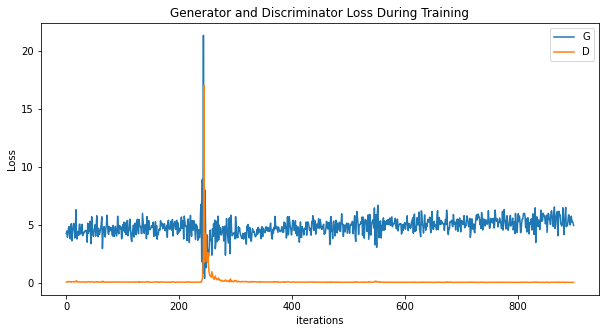

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

Animation size has reached 21230693 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


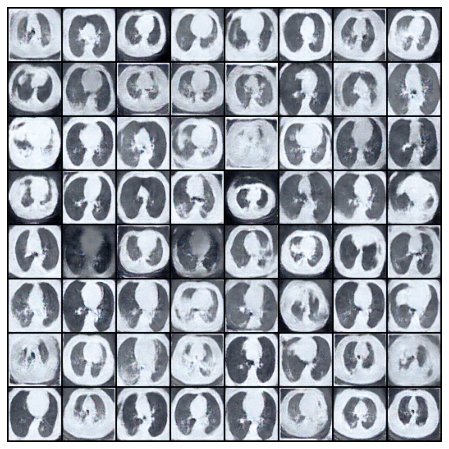

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

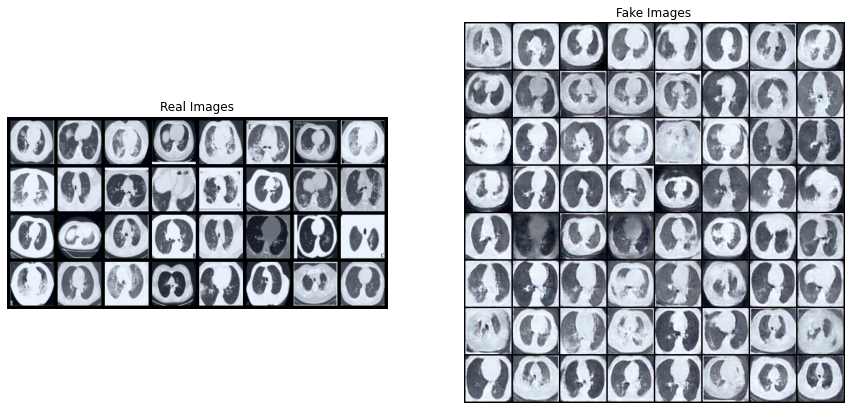

In [ ]:
real_batch = next(iter(train_dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

## 코로나 음성 데이터 생성

위 과정은 양성데이터 생성 
거의 같은 과정이나 디렉토리를 직접지정했기 때문에 다시 불러와서 사용했음.

In [ ]:
class CustomDataset(Dataset):
    def __init__(self, data_dir, input_shape):
        self.data_dir = data_dir
        # self.mode = mode
        self.input_shape = input_shape
        
        # Loading dataset
        self.db = self.data_loader()
        
        # Dataset split
#         if self.mode == 'train':
#             self.db = self.db[:int(len(self.db) * 0.9)] #train 90퍼
#         elif self.mode == 'val':
#             self.db = self.db[int(len(self.db) * 0.9):] #validation 90퍼부터 100퍼까지
#             self.db.reset_index(inplace=True)
#         else:
#             print(f'!!! Invalid split {self.mode}... !!!')
            
#         # Transform function
        self.transform = transforms.Compose([transforms.Resize(self.input_shape),
                                             transforms.ToTensor(),
                                             transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])

    def data_loader(self):
        # print('Loading ' + self.mode + ' dataset..')
        # if not os.path.isdir(self.data_dir):
        #     print(f'!!! Cannot find {self.data_dir}... !!!')
        #     sys.exit()
        
        # (COVID : 1, No : 0)
        db = pd.read_csv('./negative_label')
        
        return db

    def __len__(self):
        return len(self.db)

    def __getitem__(self, index):
        data = copy.deepcopy(self.db.loc[index])

        # Loading image
        cvimg = cv2.imread(os.path.join(self.data_dir,data['file_name']), cv2.IMREAD_COLOR | cv2.IMREAD_IGNORE_ORIENTATION)
        if not isinstance(cvimg, np.ndarray):
            raise IOError("Fail to read %s" % data['file_name'])

        # Preprocessing images
        trans_image = self.transform(Image.fromarray(cvimg))

        return trans_image, data['COVID']

In [ ]:
DATA_DIR= './negative'
NUM_CLS = 2

EPOCHS = 30
BATCH_SIZE = 32
LEARNING_RATE = 0.0005
EARLY_STOPPING_PATIENCE = 10
INPUT_SHAPE = 64

os.environ["CUDA_VISIBLE_DEVICES"]="0"
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
train_neg_dataset = CustomDataset(data_dir=DATA_DIR, input_shape=INPUT_SHAPE)
train_neg_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

In [ ]:
for i, (image,_) in enumerate(train_neg_dataloader):
    print(image.squeeze().shape)
    show_images(denorm(image), 3)
    break

In [ ]:
image_dir='../augmented_negative'

In [ ]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0


# model 2개 -> G/D
# optimizer 2개 -> G optimizer / D optimizer

real_label = torch.ones((1,), device=device, dtype=torch.float)
fake_label = torch.zeros((1,), device=device, dtype=torch.float)

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(train_neg_dataloader):
        
        # 1. Discriminator 학습
        # - input: 진짜 이미지 -> label: 1
        # - input: 가짜 이미지 (generator가 생성한 이미지) -> label: 0
        
        # 2. Generator 학습
        # - Generator input: noise, output: 가짜 이미지
        # - Discriminator input: 가짜 이미지 -> label : 1
        
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device) # 진짜이미지 
        b_size = real_cpu.size(0)
         # 모두 1로 채워진 (batch) vector
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1) # output = D(진짜이미지) 
        # output = output.type(torch.FloatTensor).cuda()
        # label = label.type(torch.FloatTensor).cuda() # long
        
        # Calculate loss on all-real batch
        errD_real = criterion(output, real_label.detach().expand(output.shape[0])) # label이랑 비교해서 학습 CELoss -> 1이되도록 학습
        # Calculate gradients for D in backward pass
        # errD_real.backward() 
        D_x = output.mean().item()
        # 진짜 이미지를 넣었을 때, discriminator가 내뱉어야하는 값? = 1

        ## Train with all-fake batch
        # 1) 가짜 이미지 만들기
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device) # Gaussian distribution
        # Generate fake image batch with G
        fake = netG(noise)

        
        # 2) 가짜 이미지를 넣으면 0을 예측하도록 학습
        # label.fill_(fake_label) # inplace 
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1) # detach? : generator 는 업데이트 안함. 
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, fake_label.detach().expand(output.shape[0]))
        # Calculate the gradients for this batch
        # errD_fake.backward()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        errD.backward()
        # Update D
        optimizerD.step()
        
        D_G_z1 = output.mean().item()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
        
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device) # Gaussian distribution
        fake = netG(noise) 
        # discriminator가 0이되도록 학습하는 fake image와
        # generator가 1이 되도록 학습하는 fake image가 같으면
        # 서로 상충되게 학습하므로 학습이 unstable해지는 경우가 있습니다.
        # 따라서, 다른 noise vector로 새로 fake 이미지를 만들어 학습합니다. (필수 아님)
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, real_label.detach().expand(output.shape[0])) # 1
        # Calculate gradients for G
        errG.backward()
        # Update G
        optimizerG.step()
        
        D_G_z2 = output.mean().item()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_neg_dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 5 == 0) or ((epoch == num_epochs-1) and (i == len(train_neg_dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
                fake = fake.numpy().transpose(0,2,3,1)
                for j in range(fake.shape[0]):
                    id =j
                    output_=fake[j]
                    output_ = np.clip(output_,a_min=0,a_max=1)
                    plt.imsave(os.path.join(image_dir,'%4d_neg_output.png' % id),output_,cmap=None)

            
        iters += 1

## 생성된 데이터 라벨 기존 트레인 데이터와 맞춰주기


In [ ]:
neg_name=os.listdir('../augmented_negative')
ben_name=os.listdir('../augmented_benign')

In [ ]:
df_augmented_negative=  pd.DataFrame(neg_name)
df_augmented_negative['COVID'] = 0
df_augmented_negative.rename(columns={0 : 'file_name'},inplace=True)
df_augmented_negative=df_augmented_negative[:-1] # ipnyb checkpoint 파일이 있어서 없애 주기 위해 작성

In [ ]:
df_augmented_benign = pd.DataFrame(ben_name)
df_augmented_benign['COVID'] = 1
df_augmented_benign.rename(columns={0 : 'file_name'},inplace=True)
df_augmented_benign= df_augmented_benign[:-1]

In [ ]:
df_augmented_negative.to_csv('neg_augmented_label',index=False)
df_augmented_benign.to_csv('ben_augmented_label',index=False)

In [ ]:
neg_label = pd.read_csv('./data/neg_augmented_label')
ben_label = pd.read_csv('./data/ben_augmented_label') #각각의 새로만든 데이터에 맞는 데이터라벨생성

In [ ]:
new_train_label=pd.concat([train_label,ben_label,neg_label],axis=0,ignore_index=True)
#기존의 트레인 라벨에 합쳐줌

In [ ]:
new_train_label.to_csv('new_train_label',index=False)

## 문제점
파일이 배치 64개밖에 저장이 안됨.. 더 많이 받고 싶을 때 어떻게 해야할 지 방법 못찾음

## Set Arguments & hyperparameters

In [ ]:
RANDOM_SEED = 2022

torch.manual_seed(RANDOM_SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(RANDOM_SEED)
random.seed(RANDOM_SEED)

In [ ]:
# parameters

### 데이터 디렉토리 설정 ###
DATA_DIR= 'data'
NUM_CLS = 2

EPOCHS = 30
BATCH_SIZE = 32
LEARNING_RATE = 0.0005
EARLY_STOPPING_PATIENCE = 20
INPUT_SHAPE = 256

os.environ["CUDA_VISIBLE_DEVICES"]="0"
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

DEVICE

## model

In [ ]:
from torchvision.models import GoogLeNet
from torchvision import models

class google_net(nn.Module):
    def __init__ (self, num_classes = 2):
        super(google_net, self).__init__()
        self.model = models.googlenet(num_classes = num_classes)
        self.softmax = nn.Softmax(dim=1)
        
    def forward(self, x):
        
        x = self.model(x)
        if isinstance(x, torch.Tensor):
            pass
        else:
            x = x.logits
        
        x = self.softmax(x)
        
        return x

## Utils
### EarlyStopper

In [ ]:
class LossEarlyStopper():
    """Early stopper
    
    Attributes:
        patience (int): loss가 줄어들지 않아도 학습할 epoch 수
        patience_counter (int): loss 가 줄어들지 않을 때 마다 1씩 증가, 감소 시 0으로 리셋
        min_loss (float): 최소 loss
        stop (bool): True 일 때 학습 중단

    """

    def __init__(self, patience: int)-> None:
        self.patience = patience

        self.patience_counter = 0
        self.min_loss = np.Inf
        self.stop = False
        self.save_model = False

    def check_early_stopping(self, loss: float)-> None:
        """Early stopping 여부 판단"""  

        if self.min_loss == np.Inf:
            self.min_loss = loss
            return None

        elif loss > self.min_loss:
            self.patience_counter += 1
            msg = f"Early stopping counter {self.patience_counter}/{self.patience}"

            if self.patience_counter == self.patience:
                self.stop = True
                
        elif loss <= self.min_loss:
            self.patience_counter = 0
            self.save_model = True
            msg = f"Validation loss decreased {self.min_loss} -> {loss}"
            self.min_loss = loss
        
        print(msg)

### Trainer

In [ ]:
class Trainer():
    """ epoch에 대한 학습 및 검증 절차 정의"""
    
    def __init__(self, loss_fn, model, device, metric_fn, optimizer=None, scheduler=None):
        """ 초기화
        """
        self.loss_fn = loss_fn
        self.model = model
        self.device = device
        self.optimizer = optimizer
        self.scheduler = scheduler
        self.metric_fn = metric_fn

    def train_epoch(self, dataloader, epoch_index):
        """ 한 epoch에서 수행되는 학습 절차"""
        
        self.model.train()
        train_total_loss = 0
        target_lst = []
        pred_lst = []
        prob_lst = []

        for batch_index, (img, label) in enumerate(dataloader):
            img = img.to(self.device)
            label = label.to(self.device).float()
            
            pred = self.model(img)
            
            loss = self.loss_fn(pred[:,1], label)
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
            self.scheduler.step()
            
            train_total_loss += loss.item()
            prob_lst.extend(pred[:, 1].cpu().tolist())
            target_lst.extend(label.cpu().tolist())
            pred_lst.extend(pred.argmax(dim=1).cpu().tolist())
        self.train_mean_loss = train_total_loss / batch_index
        self.train_score, f1 = self.metric_fn(y_pred=pred_lst, y_answer=target_lst)
        msg = f'Epoch {epoch_index}, Train loss: {self.train_mean_loss}, Acc: {self.train_score}, F1-Macro: {f1}'
        print(msg)

    def validate_epoch(self, dataloader, epoch_index):
        """ 한 epoch에서 수행되는 검증 절차
        """
        self.model.eval()
        val_total_loss = 0
        target_lst = []
        pred_lst = []
        prob_lst = []

        for batch_index, (img, label) in enumerate(dataloader):
            img = img.to(self.device)
            label = label.to(self.device).float()
            pred = self.model(img)
            
            loss = self.loss_fn(pred[:,1], label)
            val_total_loss += loss.item()
            prob_lst.extend(pred[:, 1].cpu().tolist())
            target_lst.extend(label.cpu().tolist())
            pred_lst.extend(pred.argmax(dim=1).cpu().tolist())
        self.val_mean_loss = val_total_loss / batch_index
        self.validation_score, f1 = self.metric_fn(y_pred=pred_lst, y_answer=target_lst)
        msg = f'Epoch {epoch_index}, Val loss: {self.val_mean_loss}, Acc: {self.validation_score}, F1-Macro: {f1}'
        print(msg)

### Metrics

In [ ]:
from sklearn.metrics import accuracy_score, f1_score

def get_metric_fn(y_pred, y_answer):
    """ 성능을 반환하는 함수"""
    
    assert len(y_pred) == len(y_answer), 'The size of prediction and answer are not same.'
    accuracy = accuracy_score(y_answer, y_pred)
    f1 = f1_score(y_answer, y_pred, average='macro')
    return accuracy, f1

## Train
### 학습을 위한 객체 선언

#### Load Dataset & Dataloader

In [ ]:
# Load dataset & dataloader
train_dataset = CustomDataset(data_dir=DATA_DIR, mode='train', input_shape=INPUT_SHAPE)
validation_dataset = CustomDataset(data_dir=DATA_DIR, mode='val', input_shape=INPUT_SHAPE)
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
validation_dataloader = DataLoader(validation_dataset, batch_size=BATCH_SIZE, shuffle=True)
print('Train set samples:',len(train_dataset),  'Val set samples:', len(validation_dataset))

#### Load model and other utils

In [ ]:
# Load Model
model = google_net().to(DEVICE)

# # Save Initial Model
# torch.save(model.state_dict(), 'initial.pt')

# Set optimizer, scheduler, loss function, metric function
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)
scheduler =  optim.lr_scheduler.OneCycleLR(optimizer=optimizer, pct_start=0.1, div_factor=1e5, max_lr=0.0001, epochs=EPOCHS, steps_per_epoch=len(train_dataloader))
loss_fn = nn.BCELoss()
metric_fn = get_metric_fn


# Set trainer
trainer = Trainer(loss_fn, model, DEVICE, metric_fn, optimizer, scheduler)

# Set earlystopper
early_stopper = LossEarlyStopper(patience=EARLY_STOPPING_PATIENCE)

### epoch 단위 학습 진행

In [ ]:
import wandb

wandb.init(project = 'week2_zoey', entity = 'yeardream_team_1', name = "google_net3",config={
    'lr' : LEARNING_RATE,
    'epochs' : EPOCHS,
    'batch_size' : BATCH_SIZE,
    'input_shape' : INPUT_SHAPE
})


In [ ]:
# pytorchvision model = google_net()

for epoch_index in tqdm(range(EPOCHS)):

    trainer.train_epoch(train_dataloader, epoch_index)
    trainer.validate_epoch(validation_dataloader, epoch_index)
    
    wandb.log({'train_loss' : trainer.train_mean_loss,
               'validation_loss' : trainer.val_mean_loss,
               'train_acc' : trainer.train_score,
               'validation_acc' : trainer.validation_score})

    # early_stopping check
    early_stopper.check_early_stopping(loss=trainer.val_mean_loss)

    if early_stopper.stop:
        print('Early stopped')
        break

    if early_stopper.save_model:
        check_point = {
            'model': model.state_dict(),
            'optimizer': optimizer.state_dict(),
            'scheduler': scheduler.state_dict()
        }
        torch.save(check_point, 'googlenet.pt')
wandb.finish()

## Inference
### 모델 로드

In [ ]:
TRAINED_MODEL_PATH = 'googlenet.pt'

In [ ]:
class TestDataset(Dataset):
    def __init__(self, data_dir, input_shape):
        self.data_dir = data_dir
        self.input_shape = input_shape
        
        # Loading dataset
        self.db = self.data_loader()
        
        # Transform function
        self.transform = transforms.Compose([transforms.Resize(self.input_shape),
                                             transforms.ToTensor(),
                                             transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])

    def data_loader(self):
        print('Loading test dataset..')
        if not os.path.isdir(self.data_dir):
            print(f'!!! Cannot find {self.data_dir}... !!!')
            sys.exit()
        
        db = pd.read_csv(os.path.join(self.data_dir, 'sample_submission.csv'))
        return db
    
    def __len__(self):
        return len(self.db)
    
    def __getitem__(self, index):
        data = copy.deepcopy(self.db.loc[index])
        
        # Loading image
        cvimg = cv2.imread(os.path.join(self.data_dir,'test',data['file_name']), cv2.IMREAD_COLOR | cv2.IMREAD_IGNORE_ORIENTATION)
        if not isinstance(cvimg, np.ndarray):
            raise IOError("Fail to read %s" % data['file_name'])

        # Preprocessing images
        trans_image = self.transform(Image.fromarray(cvimg))

        return trans_image, data['file_name']

In [ ]:
# Load dataset & dataloader
test_dataset = TestDataset(data_dir=DATA_DIR, input_shape=INPUT_SHAPE)
test_dataloader = DataLoader(dataset=test_dataset, batch_size=BATCH_SIZE, shuffle=False)

### 추론 진행

In [ ]:
model.load_state_dict(torch.load(TRAINED_MODEL_PATH)['model'])

# Prediction
file_lst = []
pred_lst = []
prob_lst = []
model.eval()
with torch.no_grad():
    for batch_index, (img, file_num) in tqdm(enumerate(test_dataloader)):
        img = img.to(DEVICE)
        pred = model(img)
        print(pred)
        file_lst.extend(list(file_num))
        pred_lst.extend(pred.argmax(dim=1).tolist())
        prob_lst.extend(pred[:, 1].tolist())

### 결과 저장

In [ ]:
df = pd.DataFrame({'file_name':file_lst, 'COVID':pred_lst})
# df.sort_values(by=['file_name'], inplace=True)
df.to_csv('prediction.csv', index=False)